<a href="https://colab.research.google.com/github/bu4er88/Facial_Landmarks/blob/main/Test_Faces.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [3]:
PATH_TO_FILES = '/content/drive/MyDrive/apro_software_test/APRO-AI-Tasks.zip'
DIR_TO_EXTRACT = '/content'

In [4]:
import zipfile
with zipfile.ZipFile(PATH_TO_FILES, 'r') as zip_ref:
    zip_ref.extractall(DIR_TO_EXTRACT)

In [5]:
!ls

drive  Faces.zip  Logotypes.zip  Restaurants.zip  sample_data


In [7]:
!rm -rf /content/Search_for_key_points_on_the_face

with zipfile.ZipFile('/content/Faces.zip', 'r') as zip_ref:
    zip_ref.extractall(DIR_TO_EXTRACT)

In [8]:
!ls

drive	   Logotypes.zip    sample_data
Faces.zip  Restaurants.zip  Search_for_key_points_on_the_face


In [9]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import warnings
import os
import cv2
import seaborn as sns
import time 
import tensorflow as tf
from tensorflow.keras.layers import Input, ReLU, Conv2D, MaxPooling2D, Flatten, Dense, BatchNormalization, Dropout
from tensorflow.keras.models import Model


warnings.filterwarnings("ignore")

In [10]:
WORK_DIR = os.path.join(DIR_TO_EXTRACT, 'Search_for_key_points_on_the_face/')

In [11]:
train_marks = pd.read_csv(WORK_DIR + 'train.csv')
train_marks.head()

,filename,x1,y1,x2,y2,x3,y3,x4,y4,x5,y5,x6,y6,x7,y7,x8,y8,x9,y9,x10,y10,x11,y11,x12,y12,x13,y13,x14,y14
0,05317.jpg,25,55,63,39,145,36,171,45,39,74,61,69,79,72,130,68,145,65,159,65,113,103,79,148,113,148,143,141
1,04767.jpg,17,32,39,27,56,22,81,16,20,39,32,39,43,41,66,33,73,29,86,28,56,66,45,80,59,80,74,76
2,05241.jpg,33,44,70,44,119,41,142,41,33,71,50,66,69,66,127,58,139,56,144,56,94,101,74,135,89,135,112,133
3,03849.jpg,96,157,222,143,389,129,517,125,153,210,203,198,249,210,380,196,425,181,467,188,328,339,241,451,335,453,419,441
4,00952.jpg,13,19,30,16,51,17,66,16,18,25,24,25,29,25,48,26,55,24,59,23,39,43,31,56,41,56,49,55


In [12]:
TRAIN_PATH = '/content/Search_for_key_points_on_the_face/train/'
TEST_PATH = '/content/Search_for_key_points_on_the_face/test/'

In [13]:
train_names = os.listdir(TRAIN_PATH)
test_names = os.listdir(TEST_PATH)

print(f'Train images: {len(train_names)}, Test images: {len(test_names)}')

Train images: 5000, Test images: 1000


In [14]:
train_marks.shape

(5000, 29)

In [15]:
def vertical_flip(image_name, PATH, train_marks):
    """
    Does vertical flip, save flipped image to PATH and add new 
    generated name and coordinates of flipped image to dataframe
    """ 
    BGR_image = cv2.imread(os.path.join(PATH, image_name))
    image = cv2.cvtColor(BGR_image, cv2.COLOR_BGR2RGB)
    xs = [train_marks.columns[col] for col in range(1, train_marks.shape[1]) if col%2 != 0]
    ys = [train_marks.columns[col] for col in range(1, train_marks.shape[1]) if col%2 == 0]
    x_coordinates = train_marks[train_marks.filename == image_name][xs].values
    y_coordinates = train_marks[train_marks.filename == image_name][ys].values
    # image flipping
    flipped_image = cv2.flip(image, 0)
    new_image_name = 'aug_' + image_name
    path = os.path.join(PATH, new_image_name)
    is_Written = cv2.imwrite(path, flipped_image)
    if is_Written:
	    print(f'New image is successfully saved as {path}.')
    # coordinates flipping
    new_row = {}
    new_row['filename'] = new_image_name
    for x, coordinate in zip(xs, x_coordinates[0]):
        new_row[x] = coordinate
    for y, coordinate in zip(ys, y_coordinates[0]):
        new_row[y] = image.shape[0] - coordinate
    
    return train_marks.append(new_row, ignore_index=True)

In [16]:
# Create flip image with fliped coordinates for each image
for image_name in os.listdir(TRAIN_PATH):
    train_marks = vertical_flip(image_name, TRAIN_PATH, train_marks)

# And check number of images again
train_names = os.listdir(TRAIN_PATH)
test_names = os.listdir(TEST_PATH)

print(f'Train images: {len(train_names)}, Test images: {len(test_names)}')

Streaming output truncated to the last 5000 lines.
New image is successfully saved as /content/Search_for_key_points_on_the_face/train/aug_02964.jpg.
New image is successfully saved as /content/Search_for_key_points_on_the_face/train/aug_00452.jpg.
New image is successfully saved as /content/Search_for_key_points_on_the_face/train/aug_02491.jpg.
New image is successfully saved as /content/Search_for_key_points_on_the_face/train/aug_05393.jpg.
New image is successfully saved as /content/Search_for_key_points_on_the_face/train/aug_05849.jpg.
New image is successfully saved as /content/Search_for_key_points_on_the_face/train/aug_04550.jpg.
New image is successfully saved as /content/Search_for_key_points_on_the_face/train/aug_00122.jpg.
New image is successfully saved as /content/Search_for_key_points_on_the_face/train/aug_00191.jpg.
New image is successfully saved as /content/Search_for_key_points_on_the_face/train/aug_02629.jpg.
New image is successfully saved as /content/Search_for_key

In [19]:
train_marks.tail()

,filename,x1,y1,x2,y2,x3,y3,x4,y4,x5,y5,x6,y6,x7,y7,x8,y8,x9,y9,x10,y10,x11,y11,x12,y12,x13,y13,x14,y14
9995,aug_02161.jpg,36,135,54,141,104,147,129,143,40,116,48,117,55,117,108,128,118,131,125,131,80,90,60,52,86,58,122,62
9996,aug_00737.jpg,44,188,98,184,145,182,182,195,53,163,77,162,92,159,147,158,165,164,177,167,126,105,81,72,119,72,148,78
9997,aug_03634.jpg,43,200,103,191,152,193,210,202,59,179,81,179,105,174,153,172,174,178,193,177,137,118,92,78,132,79,161,79
9998,aug_05776.jpg,35,124,68,137,118,136,144,126,39,121,55,123,72,123,109,117,123,120,133,120,84,82,65,58,88,59,111,59
9999,aug_05325.jpg,106,369,179,371,314,348,375,350,111,338,143,337,190,326,287,317,319,325,358,313,256,219,162,143,224,141,275,142


In [20]:
def show_picture_with_marks(PATH, image_name, data_with_marks):
    """Display an image along with landmarks on it"""
    image = plt.imread(os.path.join(PATH, image_name))
    plt.imshow(image)
    if data_with_marks is not None:
        xs = [data_with_marks.columns[col] for col in range(1, data_with_marks.shape[1]) if col%2 != 0]
        ys = [data_with_marks.columns[col] for col in range(1, data_with_marks.shape[1]) if col%2 == 0]
        x_coordinates = data_with_marks[data_with_marks.filename == image_name][xs].values
        y_coordinates = data_with_marks[data_with_marks.filename == image_name][ys].values
        for x, y in zip(x_coordinates, y_coordinates):
            plt.scatter(x, y, color='r')

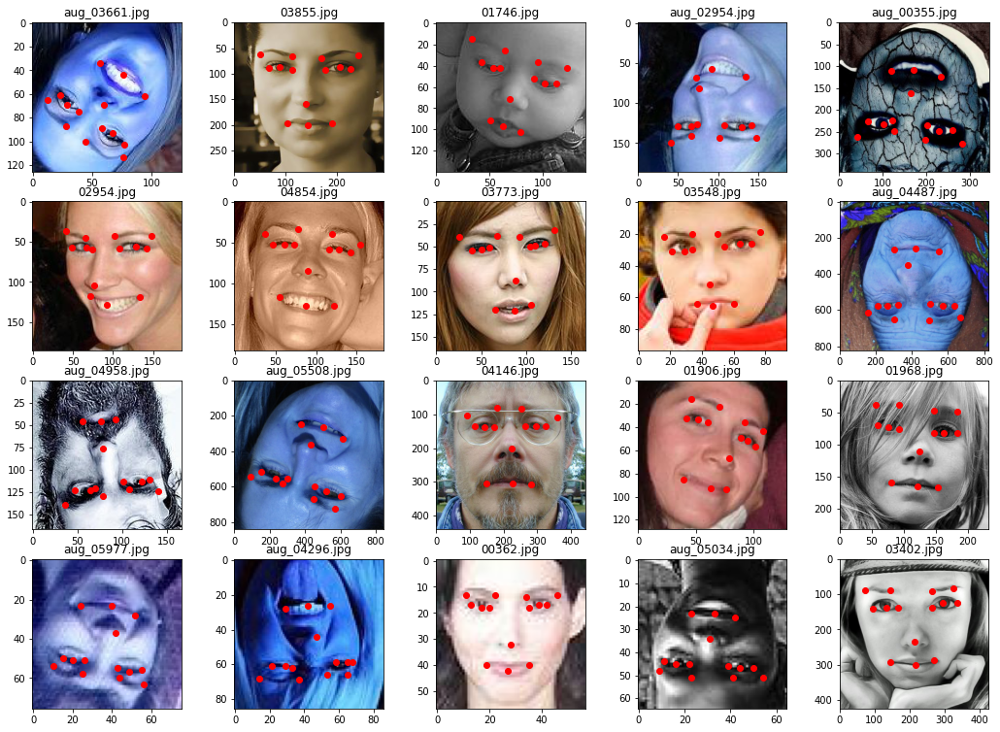

In [21]:
# look at train data
idx_to_show = np.random.randint(0, 9999, 20)
image_names_to_show = [train_names[idx] for idx in idx_to_show]

plt.figure(figsize=(18,13))
for i, image_name in enumerate(image_names_to_show):
    plt.subplot(4,5,i+1)
    show_picture_with_marks(TRAIN_PATH, image_name, train_marks)
    plt.title(image_name)

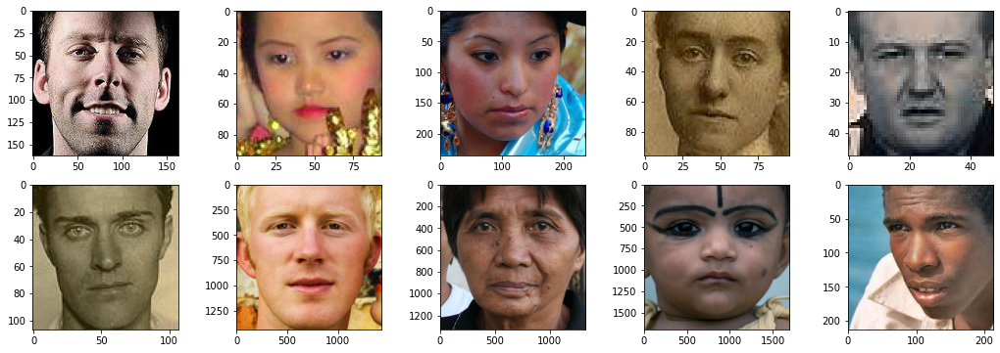

In [22]:
# look at test data
idx_to_show = np.random.randint(0, 999, 10)
image_names_to_show = [test_names[idx] for idx in idx_to_show]

plt.figure(figsize=(18,6))
for i, image_name in enumerate(image_names_to_show):
    plt.subplot(2,5,i+1)
    show_picture_with_marks(TEST_PATH, image_name, None)

In [23]:
# Get sizes of images to check mean size
def get_image_sizes(PATH):
    """Return list of image sizes from all images in a folder"""
    sizes = []
    for name in train_marks.filename:
        image = cv2.imread(os.path.join(PATH, name))
        size = image.shape
        sizes.append(size)   
    return sizes

In [24]:
train_sizes = get_image_sizes(TRAIN_PATH)

In [25]:
IMSIZE = IMSIZE = (224, 224, 3)

In [26]:
# The code bellow resize images and transform their coordinates along the dataframe

xs = [train_marks.columns[col] for col in range(1, train_marks.shape[1]) if col % 2 != 0]
ys = [train_marks.columns[col] for col in range(1, train_marks.shape[1]) if col % 2 == 0]

ratio_x = np.array(train_sizes)[:, 1] / IMSIZE[1]
ratio_y = np.array(train_sizes)[:, 0] / IMSIZE[0]

train_marks[xs] = train_marks[xs] / ratio_x.reshape(-1,1)
train_marks[ys] = train_marks[ys] / ratio_y.reshape(-1,1)

train_marks.head()

,filename,x1,y1,x2,y2,x3,y3,x4,y4,x5,y5,x6,y6,x7,y7,x8,y8,x9,y9,x10,y10,x11,y11,x12,y12,x13,y13,x14,y14
0,05317.jpg,26.046512,57.302326,65.637209,40.632558,151.069767,37.506977,178.158140,46.883721,40.632558,77.097674,63.553488,71.888372,82.306977,75.013953,135.441860,70.846512,151.069767,67.720930,165.655814,67.720930,117.730233,107.311628,82.306977,154.195349,117.730233,154.195349,148.986047,146.902326
1,04767.jpg,34.000000,64.000000,78.000000,54.000000,112.000000,44.000000,162.000000,32.000000,40.000000,78.000000,64.000000,78.000000,86.000000,82.000000,132.000000,66.000000,146.000000,58.000000,172.000000,56.000000,112.000000,132.000000,90.000000,160.000000,118.000000,160.000000,148.000000,152.000000
2,05241.jpg,37.907692,50.543590,80.410256,50.543590,136.697436,47.097436,163.117949,47.097436,37.907692,81.558974,57.435897,75.815385,79.261538,75.815385,145.887179,66.625641,159.671795,64.328205,165.415385,64.328205,107.979487,116.020513,85.005128,155.076923,102.235897,155.076923,128.656410,152.779487
3,03849.jpg,33.339535,54.524031,77.097674,49.662016,135.094574,44.800000,179.547287,43.410853,53.134884,72.930233,70.499225,68.762791,86.474419,72.930233,131.968992,68.068217,147.596899,62.858915,162.182946,65.289922,113.910078,117.730233,83.696124,156.626357,116.341085,157.320930,145.513178,153.153488
4,00952.jpg,36.400000,53.200000,84.000000,44.800000,142.800000,47.600000,184.800000,44.800000,50.400000,70.000000,67.200000,70.000000,81.200000,70.000000,134.400000,72.800000,154.000000,67.200000,165.200000,64.400000,109.200000,120.400000,86.800000,156.800000,114.800000,156.800000,137.200000,154.000000


In [27]:
def show_resized_picture_with_marks(PATH, image_name, data_with_marks):
    """Display resized images with resized landmarks"""
    BGR_image = cv2.imread(os.path.join(PATH, image_name))
    BGR_image = cv2.resize(BGR_image, (IMSIZE[0], IMSIZE[1]))
    RGBimage = cv2.cvtColor(BGR_image, cv2.COLOR_BGR2RGB)
    plt.imshow(RGBimage)
    
    xs = [data_with_marks.columns[col] for col in range(1, data_with_marks.shape[1]) if col%2 != 0]
    ys = [data_with_marks.columns[col] for col in range(1, data_with_marks.shape[1]) if col%2 == 0]

    x_coordinates = train_marks[train_marks.filename == image_name][xs].values
    y_coordinates = train_marks[train_marks.filename == image_name][ys].values
    for x, y in zip(x_coordinates, y_coordinates):
        plt.scatter(x, y, color='r')

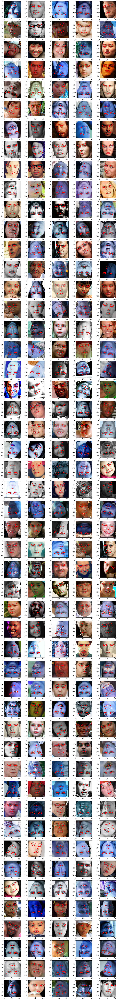

In [28]:
idx_to_show = np.random.randint(0, 9999, 250)
image_names_to_show = [train_names[idx] for idx in idx_to_show]

plt.figure(figsize=(17,150))
for i, image_name in enumerate(image_names_to_show):
    plt.subplot(50,5,i+1)
    show_resized_picture_with_marks(TRAIN_PATH, image_name, train_marks)

In [29]:
def image_to_array(image_name, PATH):
    """Does image normalization and return it as array"""
    # Read image in BGR format
    BGR_image = cv2.imread(os.path.join(PATH, image_name))
    # Resize BGR image
    BGR_image = cv2.resize(BGR_image, (IMSIZE[0], IMSIZE[1]))
    # Transform image to RGB
    image = cv2.cvtColor(BGR_image, cv2.COLOR_BGR2RGB)
    # Normalization
    image = image / 255.
    # image = (image - image.mean()) / image.std()
    return image

In [30]:
# Get X data
X_DATA = [image_to_array(name, TRAIN_PATH) for name in train_marks.filename]
# Get Y marks
Y_DATA = train_marks.drop(['filename'], axis=1)

In [31]:
from sklearn.model_selection import train_test_split

# Extract Train images and rest
X_train, X_REST, y_train, Y_REST = train_test_split(
    X_DATA, Y_DATA, test_size=0.3, random_state=42, shuffle=True
)
# Devide rest images on validation and test
X_val, X_test, y_val, y_test = train_test_split(
    X_REST, Y_REST, test_size=0.5, random_state=42, shuffle=False
)
print(f'Train set: {len(X_train)}, Validation set: {len(X_val)}, Test set: {len(X_test)}')

Train set: 7000, Validation set: 1500, Test set: 1500


In [32]:
def check_dataset(idx, x_set, y_set):
    y_set = np.array(y_set.iloc[idx, :])
    x_s = [y_set[i] for i in range(y_set.shape[0]) if i%2 == 0]
    y_s = [y_set[i] for i in range(y_set.shape[0]) if i%2 != 0]
    plt.imshow(x_set[idx])
    plt.scatter(x=x_s, y=y_s, color='r')

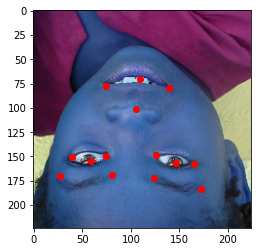

In [33]:
check_dataset(412, X_train, y_train)

In [ ]:
#@title DEEP LEARNING

In [210]:
def baseline_model():
    inputs = tf.keras.layers.Input(shape=IMSIZE)
    x = inputs
    for i in range(0, 6):
        n_filters = 2**(4 + i)
        x = Conv2D(n_filters, (3, 3))(x)
        x = BatchNormalization()(x)
        x = ReLU()(x)
        x = MaxPooling2D((2, 2), strides=2)(x)
    x = Flatten()(x)
    x = Dense(512, activation='relu')(x)
    outputs = Dense(28)(x)
    model = Model(inputs=inputs, outputs=outputs)
    return model


model = baseline_model()
model.summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 222, 222, 16)      448       
_________________________________________________________________
batch_normalization_5 (Batch (None, 222, 222, 16)      64        
_________________________________________________________________
re_lu_6 (ReLU)               (None, 222, 222, 16)      0         
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 111, 111, 16)      0         
_________________________________________________________________
conv2d_6 (Conv2D)            (None, 109, 109, 32)      4640      
_________________________________________________________________
batch_normalization_6 (Batch (None, 109, 109, 32)      128 

In [211]:
def Wing_Loss(w, e):
    """Wing loss"""
    def wing_loss(y_true, y_pred):
        x = tf.reduce_sum(tf.abs(y_true - y_pred))
        if x < w:
            loss = w * tf.math.log(1 + x/e)
        else:
            C = w - w * tf.math.log(1 + w/e)
            loss = x - C
        return loss
    return wing_loss

In [212]:
LEARNING_RATE = 1e-3
BATCH_SIZE = 10
EPOCHS = 500
optimizer = tf.optimizers.Adam(learning_rate=LEARNING_RATE)

model.compile(
    optimizer=optimizer, 
    loss=Wing_Loss(w=50, e=0.5),
    metrics='mse'
)

In [213]:
from tensorflow.keras.utils import Sequence

class Mygenerator(Sequence):
    """Data generator to feed data to the model with batches"""
    def __init__(self, x_set, y_set, BATCH_SIZE):
        self.x, self.y = x_set, y_set
        self.batch_size = BATCH_SIZE

    def __len__(self):
        return int(np.ceil(len(self.x) / float(self.batch_size)))

    def __getitem__(self, idx):
        batch_x = self.x[idx*self.batch_size : (idx + 1)*self.batch_size]
        batch_y = self.y[idx*self.batch_size : (idx + 1)*self.batch_size]

        return np.array(batch_x), np.array(batch_y)

In [214]:
train_gen = Mygenerator(X_train, y_train, BATCH_SIZE) 
val_gen = Mygenerator(X_val, y_val, BATCH_SIZE)

In [215]:
def test_model(model, test_datagen):
    length = len(val_gen.x)
    image = val_gen.x[np.random.randint(0, length)]
    pred_coords = model.predict(tf.expand_dims(image, axis=0))
    pred_coords = pred_coords[0]
    xs = [pred_coords[i] for i in range(pred_coords.shape[0]) if i % 2 == 0]
    ys = [pred_coords[i] for i in range(pred_coords.shape[0]) if i % 2 != 0]
    plt.imshow(image)
    for x, y in zip(xs, ys):
        plt.scatter(x=x, y=y, color='r')

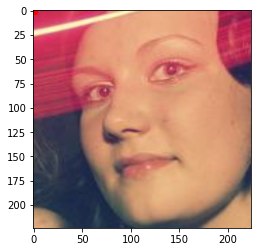

In [216]:
test_model(model, val_gen)

In [217]:
def test(model):
    test_datagen = val_gen
    plt.figure(figsize=(17, 8))
    for i in range(8):
        plt.subplot(1,8,i+1)
        test_model(model, test_datagen)
        plt.xticks([])
        plt.yticks([])
    plt.show()

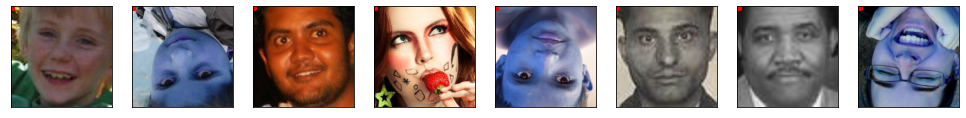

In [218]:
test(model)

In [219]:
class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)

In [220]:
def lr_schedule(epoch, lr):
    if (epoch + 1) % 20 == 0:
        lr *= 0.7
    return max(lr, 1e-7)

Epoch 1/500
700/700 - 10s - loss: 4010.5122 - mse: 557.3876 - val_loss: 2345.1531 - val_mse: 144.8403


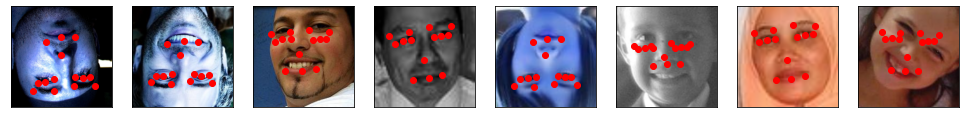

Epoch 2/500
700/700 - 9s - loss: 2202.3220 - mse: 123.6138 - val_loss: 2817.3953 - val_mse: 165.3636


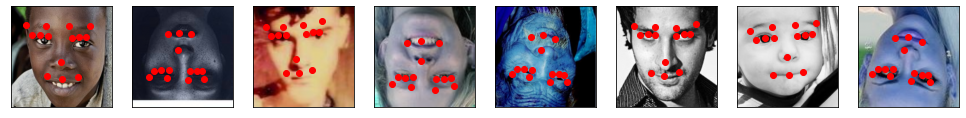

Epoch 3/500
700/700 - 9s - loss: 1934.7559 - mse: 94.7629 - val_loss: 1919.1659 - val_mse: 101.7807


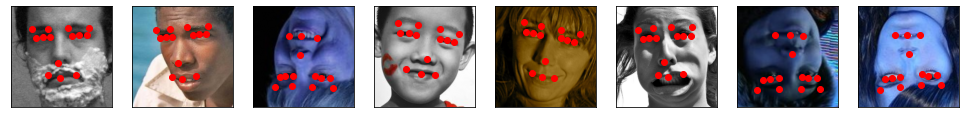

Epoch 4/500
700/700 - 8s - loss: 1767.2896 - mse: 79.7188 - val_loss: 1877.5251 - val_mse: 97.2906


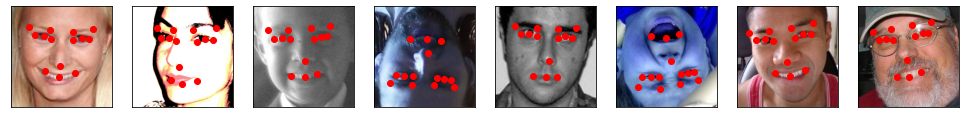

Epoch 5/500
700/700 - 9s - loss: 1696.9388 - mse: 71.6341 - val_loss: 1898.9985 - val_mse: 95.2735


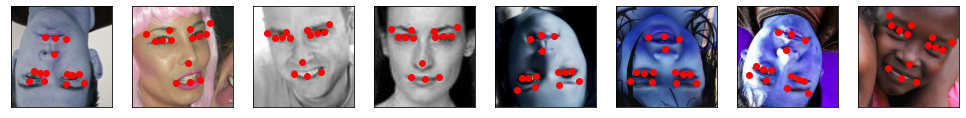

Epoch 6/500
700/700 - 9s - loss: 1586.1981 - mse: 62.5913 - val_loss: 1648.3218 - val_mse: 76.7392


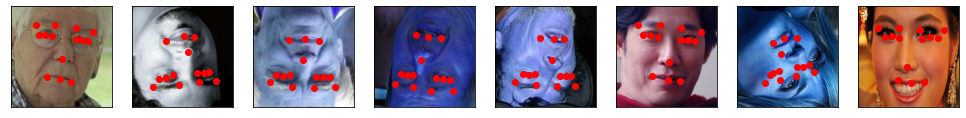

Epoch 7/500
700/700 - 9s - loss: 1554.2062 - mse: 58.9217 - val_loss: 1621.0529 - val_mse: 75.9255


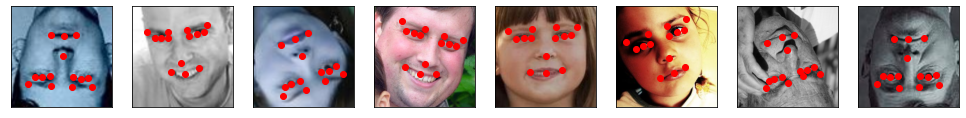

Epoch 8/500
700/700 - 8s - loss: 1482.6412 - mse: 52.9151 - val_loss: 1640.1010 - val_mse: 74.1201


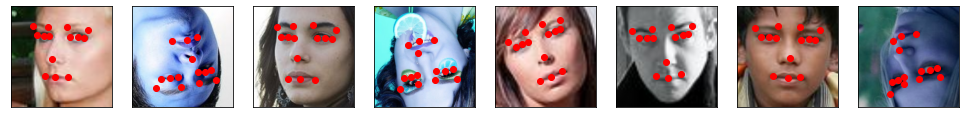

Epoch 9/500
700/700 - 9s - loss: 1452.3293 - mse: 49.8714 - val_loss: 2071.7576 - val_mse: 99.2837


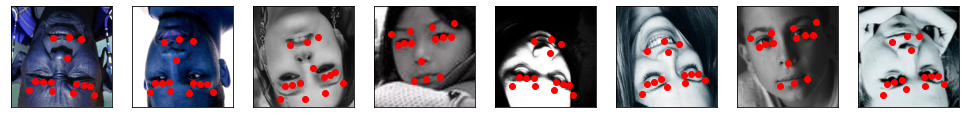

Epoch 10/500
700/700 - 9s - loss: 1391.2073 - mse: 44.8015 - val_loss: 1582.7823 - val_mse: 65.5381


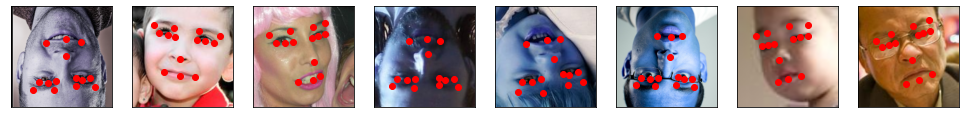

Epoch 11/500
700/700 - 8s - loss: 1376.0011 - mse: 42.8203 - val_loss: 1535.7803 - val_mse: 70.1213


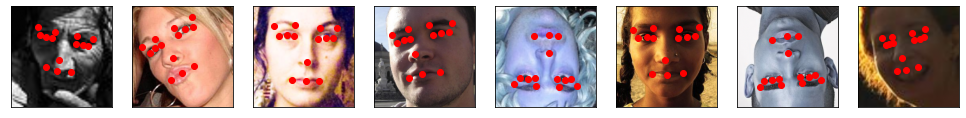

Epoch 12/500
700/700 - 9s - loss: 1330.6570 - mse: 39.2948 - val_loss: 1869.1392 - val_mse: 83.6645


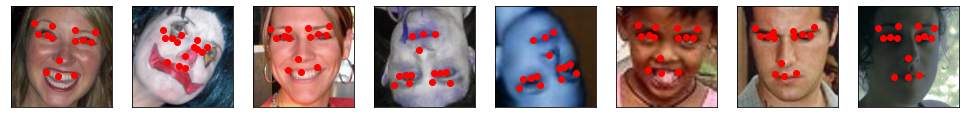

Epoch 13/500
700/700 - 9s - loss: 1324.2990 - mse: 37.9318 - val_loss: 1537.4904 - val_mse: 63.5436


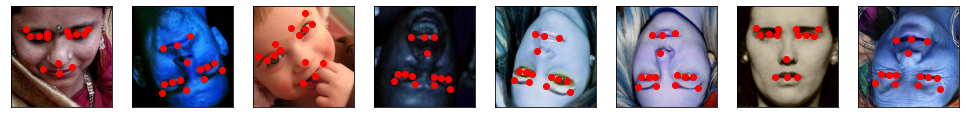

Epoch 14/500
700/700 - 9s - loss: 1285.0216 - mse: 35.1360 - val_loss: 1461.6630 - val_mse: 58.7014


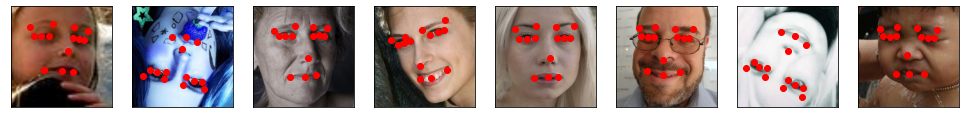

Epoch 15/500
700/700 - 9s - loss: 1274.5106 - mse: 34.1288 - val_loss: 1505.2410 - val_mse: 65.9369


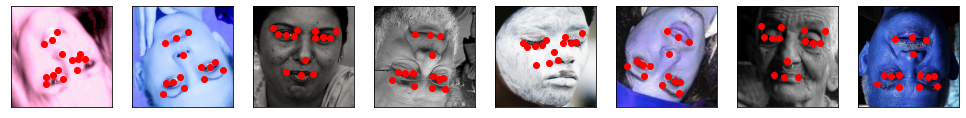

Epoch 16/500
700/700 - 9s - loss: 1243.5873 - mse: 31.9526 - val_loss: 1561.0507 - val_mse: 63.6479


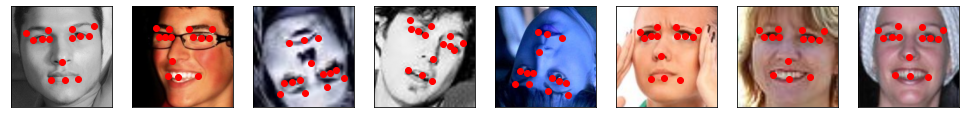

Epoch 17/500
700/700 - 9s - loss: 1225.5498 - mse: 30.3260 - val_loss: 1465.6963 - val_mse: 59.7649


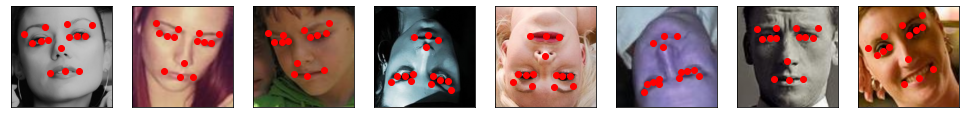

Epoch 18/500
700/700 - 9s - loss: 1203.6978 - mse: 29.0056 - val_loss: 1462.1288 - val_mse: 56.3487


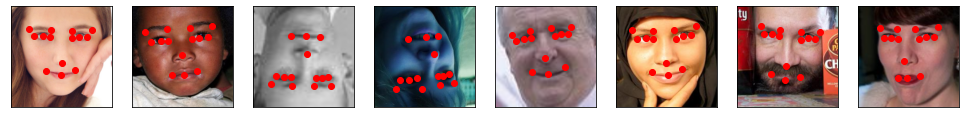

Epoch 19/500
700/700 - 9s - loss: 1178.3816 - mse: 27.6303 - val_loss: 1409.3523 - val_mse: 54.0710


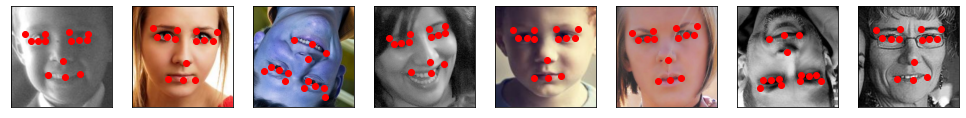

Epoch 20/500
700/700 - 9s - loss: 1105.9248 - mse: 24.5443 - val_loss: 1399.7300 - val_mse: 56.0882


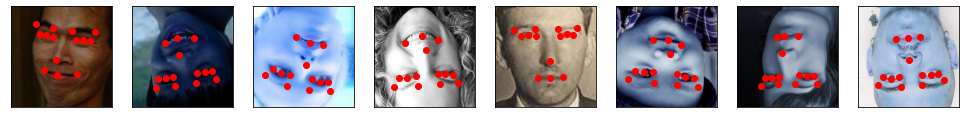

Epoch 21/500
700/700 - 9s - loss: 1080.3204 - mse: 23.1164 - val_loss: 1377.0631 - val_mse: 54.6228


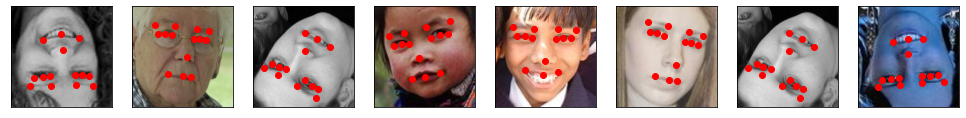

Epoch 22/500
700/700 - 9s - loss: 1065.4886 - mse: 22.4156 - val_loss: 1391.6843 - val_mse: 51.9261


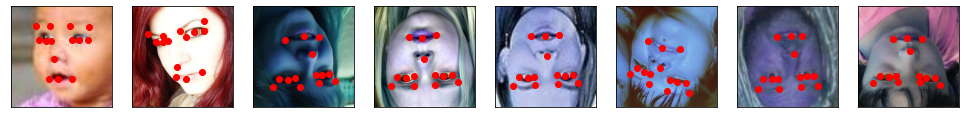

Epoch 23/500
700/700 - 9s - loss: 1058.0663 - mse: 22.0216 - val_loss: 1386.2107 - val_mse: 51.7713


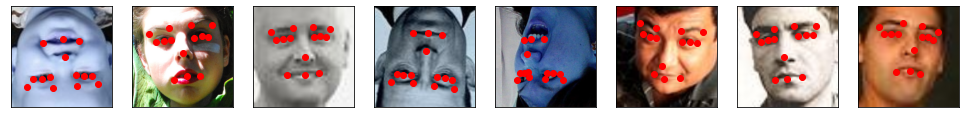

Epoch 24/500
700/700 - 9s - loss: 1039.4915 - mse: 21.2095 - val_loss: 1379.4386 - val_mse: 52.8733


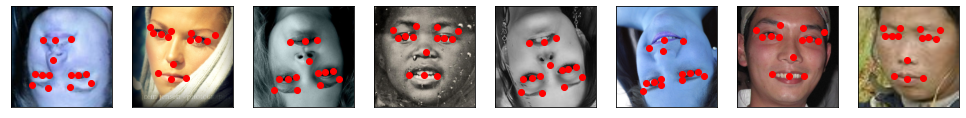

Epoch 25/500
700/700 - 8s - loss: 1039.0869 - mse: 21.0225 - val_loss: 1354.8628 - val_mse: 51.4755


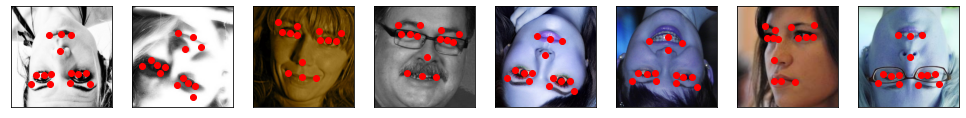

Epoch 26/500
700/700 - 9s - loss: 1017.6056 - mse: 20.1733 - val_loss: 1364.8860 - val_mse: 51.3375


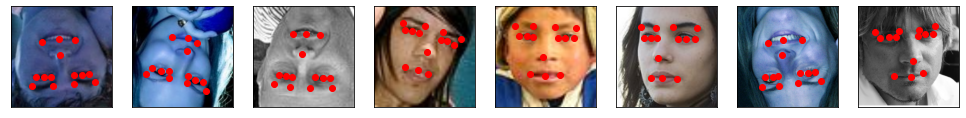

Epoch 27/500
700/700 - 9s - loss: 1004.2261 - mse: 19.6246 - val_loss: 1382.6412 - val_mse: 52.8118


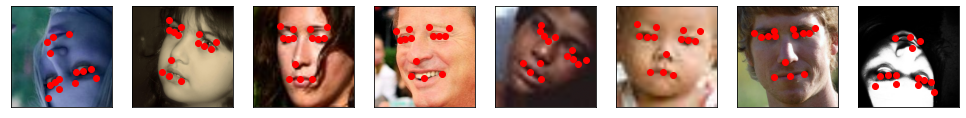

Epoch 28/500
700/700 - 8s - loss: 1002.4731 - mse: 19.4166 - val_loss: 1367.0088 - val_mse: 51.5694


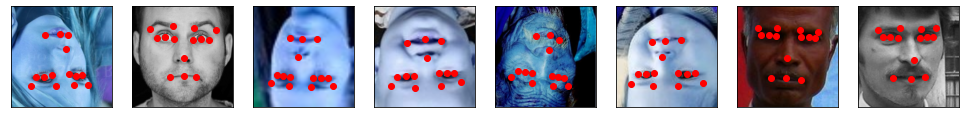

Epoch 29/500
700/700 - 9s - loss: 990.5293 - mse: 19.0495 - val_loss: 1409.8917 - val_mse: 54.3542


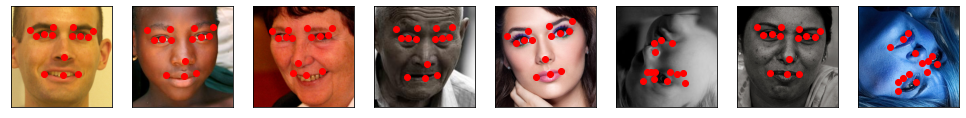

Epoch 30/500
700/700 - 9s - loss: 970.4493 - mse: 18.2411 - val_loss: 1354.0559 - val_mse: 51.3937


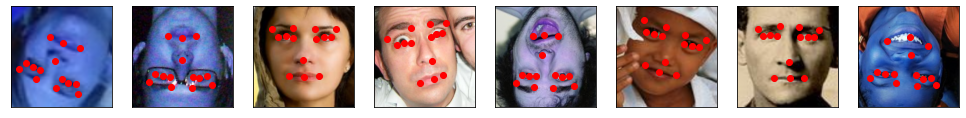

Epoch 31/500
700/700 - 9s - loss: 966.0043 - mse: 17.9244 - val_loss: 1423.4912 - val_mse: 57.3614


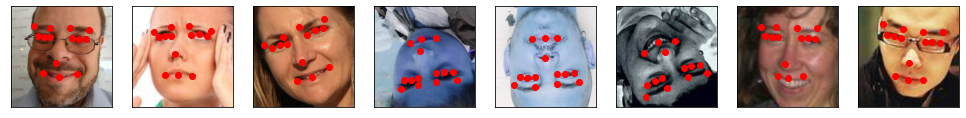

Epoch 32/500
700/700 - 8s - loss: 954.7784 - mse: 17.5445 - val_loss: 1342.4408 - val_mse: 50.5085


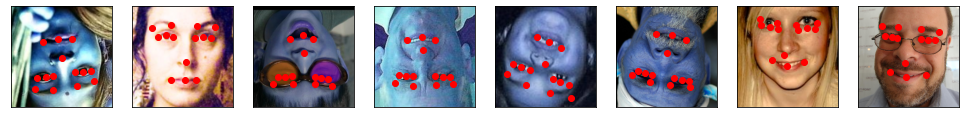

Epoch 33/500
700/700 - 9s - loss: 951.1544 - mse: 17.3932 - val_loss: 1374.8489 - val_mse: 53.5386


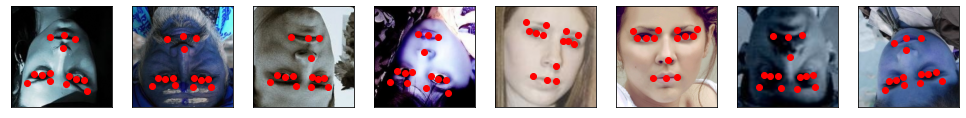

Epoch 34/500
700/700 - 9s - loss: 933.1369 - mse: 16.7098 - val_loss: 1401.2690 - val_mse: 53.3700


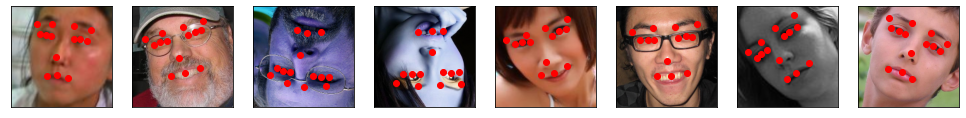

Epoch 35/500
700/700 - 9s - loss: 922.9673 - mse: 16.4367 - val_loss: 1368.8182 - val_mse: 52.4933


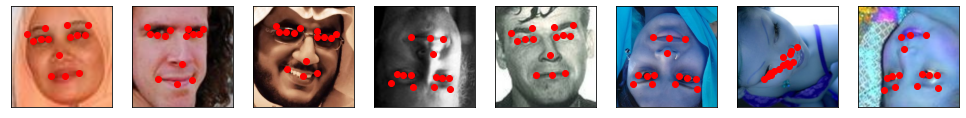

Epoch 36/500
700/700 - 8s - loss: 916.6033 - mse: 16.1120 - val_loss: 1360.8441 - val_mse: 51.8895


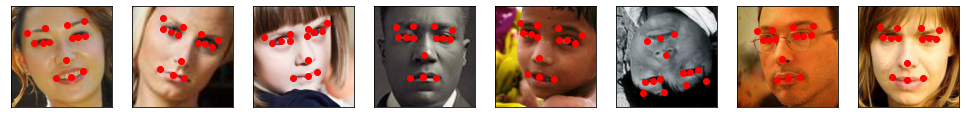

Epoch 37/500
700/700 - 9s - loss: 904.8250 - mse: 15.6815 - val_loss: 1385.0743 - val_mse: 52.5246


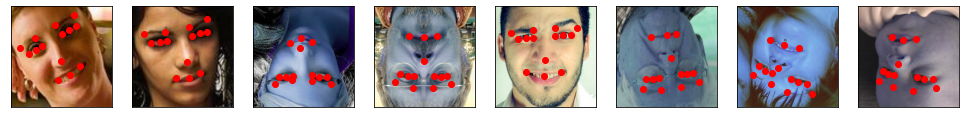

Epoch 38/500
700/700 - 9s - loss: 895.4155 - mse: 15.2897 - val_loss: 1392.9930 - val_mse: 54.6180


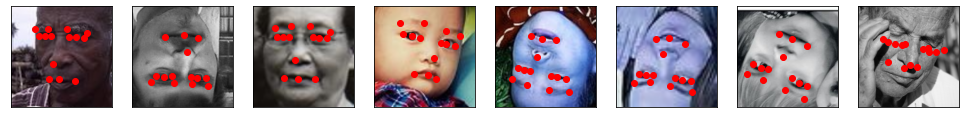

Epoch 39/500
700/700 - 8s - loss: 895.7703 - mse: 15.2496 - val_loss: 1378.8429 - val_mse: 52.1501


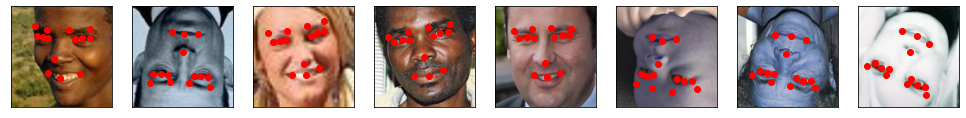

Epoch 40/500
700/700 - 9s - loss: 842.9781 - mse: 13.7497 - val_loss: 1351.9838 - val_mse: 52.2292


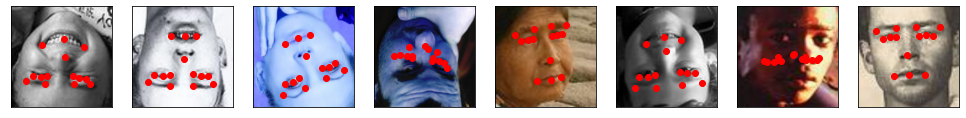

Epoch 41/500
700/700 - 9s - loss: 815.5527 - mse: 12.9409 - val_loss: 1357.7200 - val_mse: 51.2263


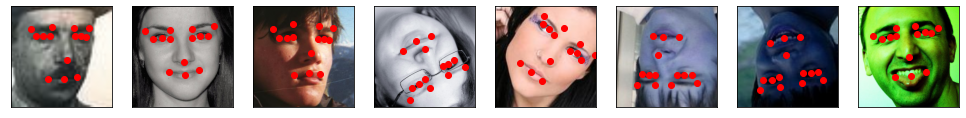

Epoch 42/500
700/700 - 8s - loss: 805.4098 - mse: 12.6363 - val_loss: 1359.4775 - val_mse: 52.5556


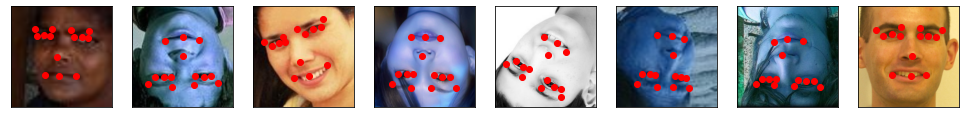

Training time: 414.0 s.


In [221]:
tic = time.time()
history = model.fit(
    train_gen, 
    validation_data=val_gen,
    epochs=EPOCHS,
    shuffle=True,
    initial_epoch=0,
    callbacks=[
               ShowTestImages(),
               tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, mode='min'),
               tf.keras.callbacks.LearningRateScheduler(lr_schedule)
    ],
    verbose=2)
toc = time.time()
print(f'Training time: {round(toc-tic, 0)} s.')

In [82]:
history_df = pd.DataFrame(history.history)

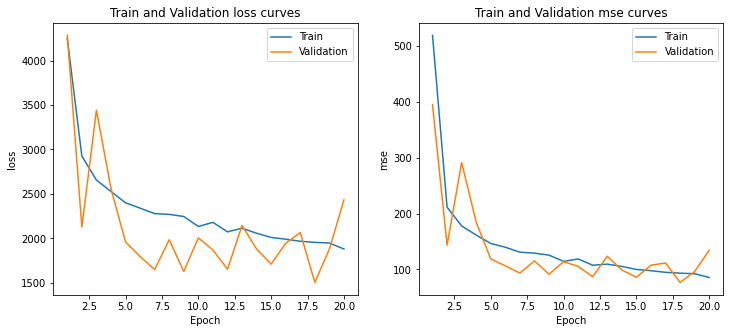

In [83]:
plt.figure(figsize=(12, 5))
plt.subplot(1,2,1)
sns.lineplot(range(1, history_df.shape[0]+1), history_df.loss)
sns.lineplot(range(1, history_df.shape[0]+1), history_df.val_loss)
plt.xlabel('Epoch')
plt.title('Train and Validation loss curves')
plt.legend(['Train', 'Validation'])
plt.subplot(1,2,2)
sns.lineplot(range(1, history_df.shape[0]+1), history_df.mse)
sns.lineplot(range(1, history_df.shape[0]+1), history_df.val_mse)
plt.xlabel('Epoch')
plt.title('Train and Validation mse curves')
plt.legend(['Train', 'Validation'])
plt.show()

In [49]:
predictions = model.predict(np.array(X_test))

In [ ]:
# Put filename into y_test dataframe
y_test_with_filenames = y_test.join(train_marks.filename)
# Retrieve filenames
test_names = y_test_with_filenames.filename.values
# Create dataframe from predictions
predictions_df = pd.DataFrame(predictions, index=test_names).reset_index()

# Look at new dataframes
#display(y_test_with_filenames.head())
#display(predictions_df.head())

In [ ]:
def show_predicted_marks(PATH, image_name, data_with_marks):
    """Display predicted marks in blue color"""
    xs = [data_with_marks.columns[col] 
          for col in range(1, data_with_marks.shape[1]) 
          if col%2 != 0]
    ys = [data_with_marks.columns[col] 
          for col in range(1, data_with_marks.shape[1]) 
          if col%2 == 0]
    # Get X's and Y's coordinates
    x = data_with_marks[data_with_marks.iloc[:, 0] == image_name][xs].values
    y = data_with_marks[data_with_marks.iloc[:, 0] == image_name][ys].values
    for x, y in zip(x, y):
        plt.scatter(x, y, color='b')

In [ ]:
# Set function to retrieve filename by index
def image_name_by_index(idx_to_show, dataframe):
    names = [dataframe[dataframe.index == idx].filename.item() for idx in idx_to_show]
    return names

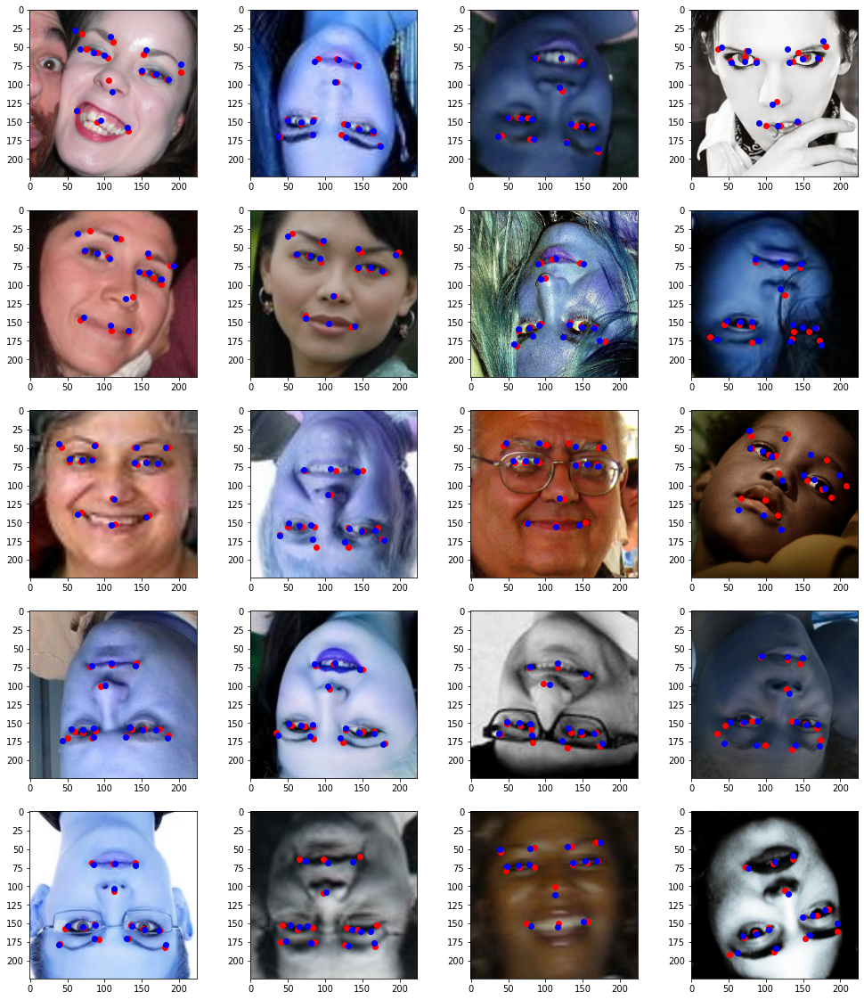

In [ ]:
# Look at allocated test data with ground truth marks (red) and predicted ones (blue)

idx_to_show = np.random.choice(y_test_with_filenames.index, 20)
image_names_to_show = image_name_by_index(
                        idx_to_show, y_test_with_filenames
)
plt.figure(figsize=(17,20))
for i, image_name in enumerate(image_names_to_show):
    plt.subplot(5,4,i+1)
    show_resized_picture_with_marks(TRAIN_PATH, image_name, train_marks)
    show_predicted_marks(TRAIN_PATH, image_name, predictions_df)

In [ ]:
model.save_weights('/content/baseline_model_wingloss_weights.h5')
#loaded_model = tf.keras.models.load_model('/content/baseline_model_weights.h5')

In [ ]:
#@title FEATURE EXTRACTION AND FINE TUNING

In [84]:
IMSIZE = (224, 224, 3)

# Get train sizes according to dataframe name order
sizes = []
for name in train_marks.filename:
    image = cv2.imread(os.path.join(TRAIN_PATH, name))
    size = image.shape
    sizes.append(size)

In [85]:
# Rescale coordinates of marks

xs = [train_marks.columns[col] for col in range(1, train_marks.shape[1]) if col % 2 != 0]
ys = [train_marks.columns[col] for col in range(1, train_marks.shape[1]) if col % 2 == 0]

ratio_x = np.array(sizes)[:, 0] / IMSIZE[0]
ratio_y = np.array(sizes)[:, 1] / IMSIZE[1]

train_marks[xs] = train_marks[xs] / ratio_x.reshape(-1,1)
train_marks[ys] = train_marks[ys] / ratio_y.reshape(-1,1)

In [ ]:
# Get X data
X_DATA = [image_to_array(name, TRAIN_PATH) for name in train_marks.filename]
# Get Y marks
Y_DATA = train_marks.drop(['filename'], axis=1)

In [ ]:
from sklearn.model_selection import train_test_split

# Extract Train data and rest data
X_train, X_REST, y_train, Y_REST = train_test_split(
    X_DATA, Y_DATA, test_size=0.3, random_state=42, shuffle=True)
# Devide rest data on validation and test
X_val, X_test, y_val, y_test = train_test_split(
    X_REST, Y_REST, test_size=0.5, random_state=42, shuffle=False)

In [37]:
base_model = tf.keras.applications.ResNet50(include_top=False, 
                                            weights='imagenet', 
                                            input_shape=(224, 224, 3), 
                                            pooling='avg')
#base_model.summary()

94773248/94765736 [==============================] - 1s 0us/step


In [38]:
base_model.trainable = True

'''for layer in base_model.layers[-21:]:
    layer.trainable = True'''

'for layer in base_model.layers[-21:]:\n    layer.trainable = True'

In [39]:
for i, layer in enumerate(base_model.layers):
    print(i, layer.trainable, end=', ')

0 True, 1 True, 2 True, 3 True, 4 True, 5 True, 6 True, 7 True, 8 True, 9 True, 10 True, 11 True, 12 True, 13 True, 14 True, 15 True, 16 True, 17 True, 18 True, 19 True, 20 True, 21 True, 22 True, 23 True, 24 True, 25 True, 26 True, 27 True, 28 True, 29 True, 30 True, 31 True, 32 True, 33 True, 34 True, 35 True, 36 True, 37 True, 38 True, 39 True, 40 True, 41 True, 42 True, 43 True, 44 True, 45 True, 46 True, 47 True, 48 True, 49 True, 50 True, 51 True, 52 True, 53 True, 54 True, 55 True, 56 True, 57 True, 58 True, 59 True, 60 True, 61 True, 62 True, 63 True, 64 True, 65 True, 66 True, 67 True, 68 True, 69 True, 70 True, 71 True, 72 True, 73 True, 74 True, 75 True, 76 True, 77 True, 78 True, 79 True, 80 True, 81 True, 82 True, 83 True, 84 True, 85 True, 86 True, 87 True, 88 True, 89 True, 90 True, 91 True, 92 True, 93 True, 94 True, 95 True, 96 True, 97 True, 98 True, 99 True, 100 True, 101 True, 102 True, 103 True, 104 True, 105 True, 106 True, 107 True, 108 True, 109 True, 110 True, 

In [41]:
# Fix model architecture for the regression task

def model():
    input = Input(shape=IMSIZE)    
    x = base_model(input, training=True)
    #x = Flatten()(x)
    #x = Dropout(0.5)(x)
    x = Dense(4096)(x)
    x = ReLU()(x)
    #x = Dropout(0.5)(x)                   
    #x = Dense(256)(x)
    #x = BatchNormalization()(x)
    #x = ReLU()(x)
    output = Dense(28)(x)
    model = Model(inputs=input, outputs=output)
    return model


model = model()
model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
resnet50 (Functional)        (None, 2048)              23587712  
_________________________________________________________________
dense (Dense)                (None, 4096)              8392704   
_________________________________________________________________
re_lu (ReLU)                 (None, 4096)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 28)                114716    
Total params: 32,095,132
Trainable params: 32,042,012
Non-trainable params: 53,120
_________________________________________________________________


In [ ]:
LEARNING_RATE = 1e-4
BATCH_SIZE = 10
EPOCHS = 50

train_gen = Mygenerator(X_train, y_train, BATCH_SIZE) 
val_gen = Mygenerator(X_val, y_val, BATCH_SIZE)

optimizer = tf.optimizers.Adam(learning_rate=LEARNING_RATE)
model.compile(optimizer=optimizer, 
              loss=Wing_Loss(w=10, e=2),
              metrics=['mse'])
tic = time.time()
history = model.fit_generator(train_gen,    
                              validation_data=val_gen,
                              epochs=EPOCHS,
                              shuffle=True,
                              initial_epoch=0,
                              verbose=2)
toc = time.time()
print(f'Training time: {round(toc-tic, 0)} s.')

Epoch 1/50
700/700 - 75s - loss: 3742.3218 - mse: 669.7043 - val_loss: 1655.1771 - val_mse: 89.2335
Epoch 2/50
700/700 - 53s - loss: 1515.8357 - mse: 63.4919 - val_loss: 1456.5056 - val_mse: 66.9161
Epoch 3/50
700/700 - 53s - loss: 1287.2953 - mse: 46.6014 - val_loss: 1285.5923 - val_mse: 56.8648
Epoch 4/50
700/700 - 53s - loss: 1169.6278 - mse: 38.5547 - val_loss: 1261.0625 - val_mse: 53.0816
Epoch 5/50
700/700 - 53s - loss: 1109.6400 - mse: 34.2937 - val_loss: 1184.2473 - val_mse: 48.1475
Epoch 6/50
700/700 - 53s - loss: 1049.5044 - mse: 31.0559 - val_loss: 1153.1898 - val_mse: 50.1316
Epoch 7/50
700/700 - 53s - loss: 1004.0770 - mse: 28.1871 - val_loss: 1164.0513 - val_mse: 45.5434
Epoch 8/50
700/700 - 53s - loss: 978.9878 - mse: 25.9084 - val_loss: 1114.9131 - val_mse: 45.7382
Epoch 9/50
700/700 - 53s - loss: 927.1545 - mse: 23.8145 - val_loss: 1089.6061 - val_mse: 45.7783
Epoch 10/50
700/700 - 53s - loss: 898.6537 - mse: 21.9227 - val_loss: 1086.7123 - val_mse: 42.5630
Epoch 11/50

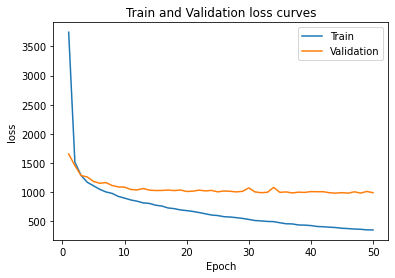

In [ ]:
history_df = pd.DataFrame(history.history)
history_df.head()

sns.lineplot(range(1, EPOCHS+1), history_df.loss)
sns.lineplot(range(1, EPOCHS+1), history_df.val_loss)
plt.xlabel('Epoch')
plt.title('Train and Validation loss curves')
plt.legend(['Train', 'Validation'])
plt.show()

In [ ]:
# Predict coordinates
predictions = model.predict(np.array(X_test))
# Put filename into y_test dataframe
y_test_with_filenames = y_test.join(train_marks.filename)
# Retrieve filenames
test_names = y_test_with_filenames.filename.values
# Create dataframe from predictions
predictions_df = pd.DataFrame(predictions, index=test_names).reset_index()

# Look at new dataframes
#display(y_test_with_filenames.head())
#display(predictions_df.head())

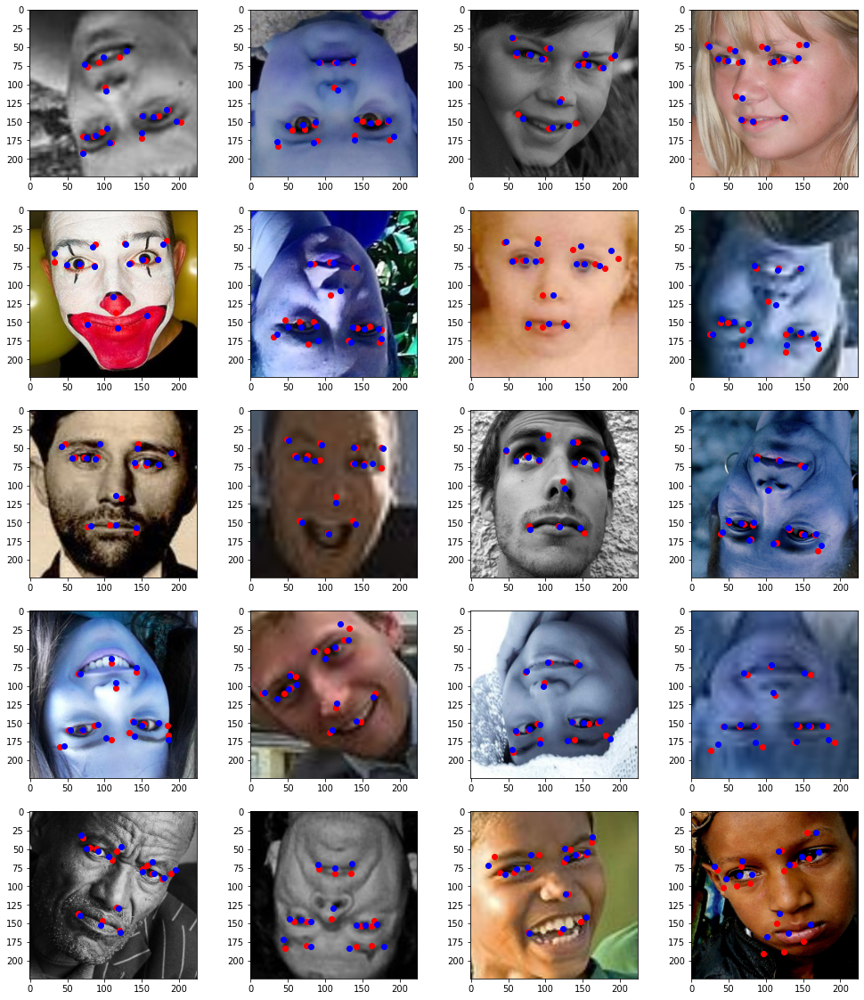

In [ ]:
# Look at allocated test data with ground truth marks (red) and predicted ones (blue)
idx_to_show = np.random.choice(y_test_with_filenames.index, 20)

image_names_to_show = image_name_by_index(
    idx_to_show, y_test_with_filenames
)
plt.figure(figsize=(17,20))
for i, image_name in enumerate(image_names_to_show):
    plt.subplot(5,4,i+1)
    show_resized_picture_with_marks(TRAIN_PATH, image_name, train_marks)
    show_predicted_marks(TRAIN_PATH, image_name, predictions_df)

In [ ]:
model.save_weights('/content/resnet_model_weights1.h5')

In [47]:
model.load_weights('/content/drive/MyDrive/apro_software_test/resnet_model_wingloss_weights1.h5')
LEARNING_RATE = 1e-4
optimizer = tf.optimizers.Adam(learning_rate=LEARNING_RATE)
model.compile(optimizer=optimizer, 
              loss=Wing_Loss(w=10, e=2),
              metrics=['mse'])

In [48]:
model.evaluate(x=np.array(X_test), y=y_test)

47/47 [==============================] - 22s 71ms/step - loss: 2622.5714 - mse: 26.2753


[2579.629638671875, 25.855005264282227]

In [ ]:
#################################################
#################################################
# VGG16 # VGG16 # VGG16 # VGG16 # VGG16 # VGG16 #
#################################################
#################################################

In [ ]:
base_model = tf.keras.applications.VGG16(include_top=False, 
                                         weights='imagenet', 
                                         input_shape=(224, 224, 3), 
                                         pooling='avg')
base_model.trainable = True
# base_model.summary()

In [ ]:
# Fix model architecture for the regression task
def model():
    input = Input(shape=IMSIZE)
    x = base_model(input, training=True)
    #x = Flatten()(x)
    x = Dense(4096)(x)
    x = ReLU()(x)
    x = Dropout(0.2)(x)
    output = Dense(28)(x)
    model = Model(inputs=input, outputs=output)
    return model


model = model()
model.summary()

Model: "model_12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_26 (InputLayer)        [(None, 224, 224, 3)]     0         
_________________________________________________________________
vgg16 (Functional)           (None, 512)               14714688  
_________________________________________________________________
dense_24 (Dense)             (None, 4096)              2101248   
_________________________________________________________________
re_lu_12 (ReLU)              (None, 4096)              0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 4096)              0         
_________________________________________________________________
dense_25 (Dense)             (None, 28)                114716    
Total params: 16,930,652
Trainable params: 16,930,652
Non-trainable params: 0
______________________________________________

In [ ]:
LEARNING_RATE = 1e-4
BATCH_SIZE = 5
EPOCHS = 50

train_gen = Mygenerator(X_train, y_train, BATCH_SIZE) 
val_gen = Mygenerator(X_val, y_val, BATCH_SIZE)

optimizer = tf.optimizers.Adam(learning_rate=LEARNING_RATE)
model.compile(optimizer=optimizer, loss=Wing_Loss(w=10, e=2), metrics='mse')

tic = time.time()
history = model.fit_generator(train_gen,
                              validation_data=val_gen,
                              epochs=EPOCHS,
                              shuffle=True,
                              initial_epoch=0,
                              verbose=1)
toc = time.time()
print(f'Training time: {round(toc-tic, 0)} s.')

Epoch 1/50
1400/1400 [==============================] - 72s 51ms/step - loss: 3816.6386 - mse: 1604.0793 - val_loss: 1984.6428 - val_mse: 599.4997
Epoch 2/50
1400/1400 [==============================] - 71s 51ms/step - loss: 1949.9606 - mse: 459.1518 - val_loss: 1717.5093 - val_mse: 347.9910
Epoch 3/50
1400/1400 [==============================] - 71s 51ms/step - loss: 1555.0309 - mse: 256.4843 - val_loss: 1285.8007 - val_mse: 198.8763
Epoch 4/50
1400/1400 [==============================] - 71s 51ms/step - loss: 1432.2514 - mse: 214.3237 - val_loss: 1300.3439 - val_mse: 191.4488
Epoch 5/50
1400/1400 [==============================] - 71s 51ms/step - loss: 1320.9245 - mse: 184.3687 - val_loss: 1369.8701 - val_mse: 196.5359
Epoch 6/50
1400/1400 [==============================] - 71s 51ms/step - loss: 1246.4633 - mse: 168.5500 - val_loss: 1041.6252 - val_mse: 140.7447
Epoch 7/50
1400/1400 [==============================] - 71s 51ms/step - loss: 1077.8266 - mse: 125.9466 - val_loss: 979.953

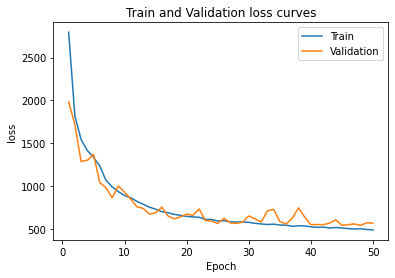

In [ ]:
history_df = pd.DataFrame(history.history)
history_df.head()

sns.lineplot(range(1, EPOCHS+1), history_df.loss)
sns.lineplot(range(1, EPOCHS+1), history_df.val_loss)
# sns.lineplot(range(10, EPOCHS+1), history_df.loss[9:])
# sns.lineplot(range(10, EPOCHS+1), history_df.val_loss[9:])
plt.xlabel('Epoch')
plt.title('Train and Validation loss curves')
plt.legend(['Train', 'Validation'])
plt.show()

In [ ]:
# Predict coordinates
predictions = model.predict(np.array(X_test))
# Put filename into y_test dataframe
y_test_with_filenames = y_test.join(train_marks.filename)
# Retrieve filenames
test_names = y_test_with_filenames.filename.values
# Create dataframe from predictions
predictions_df = pd.DataFrame(predictions, index=test_names).reset_index()

# Look at new dataframes
#display(y_test_with_filenames.head())
#display(predictions_df.head())

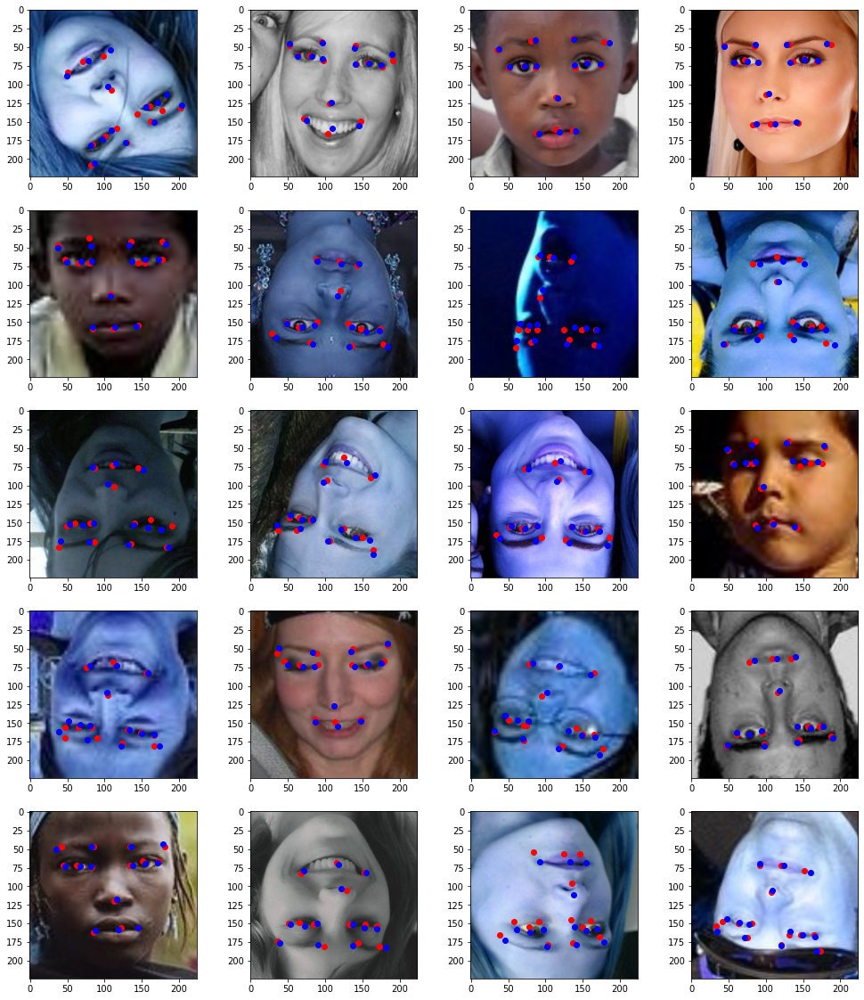

In [ ]:
# Look at allocated test data with ground truth marks (red) and predicted ones (blue)
idx_to_show = np.random.choice(y_test_with_filenames.index, 20)

image_names_to_show = image_name_by_index(
                        idx_to_show, y_test_with_filenames)

plt.figure(figsize=(17,20))
for i, image_name in enumerate(image_names_to_show):
    plt.subplot(5,4,i+1)
    show_resized_picture_with_marks(TRAIN_PATH, image_name, train_marks)
    show_predicted_marks(TRAIN_PATH, image_name, predictions_df)

In [ ]:
model.save_weights('/content/vgg16_model_weights1.h5')
#loaded_model = tf.keras.models.load_model('/content/baseline_model_weights.h5')

In [ ]:
model.load_weights('/content/vgg16_model_weights1.h5')

optimizer = tf.optimizers.Adam(learning_rate=LEARNING_RATE)
model.compile(optimizer=optimizer, 
              loss=Wing_Loss(w=10, e=2), 
              metrics='mse')

model.evaluate(x=np.array(X_test), y=y_test)

47/47 [==============================] - 3s 64ms/step - loss: 3522.2766 - mse: 44.1287


[3514.039306640625, 44.78178024291992]

In [ ]:
#@title INFERENCE

In [50]:
test_names = os.listdir(TEST_PATH)

In [51]:
TEST_DATA = [image_to_array(name, TEST_PATH) for name in test_names]

sizes = []
for name in test_names:
    image = cv2.imread(os.path.join(TEST_PATH, name))
    size = image.shape
    sizes.append(size)

In [52]:
PREDICTIONS = model.predict(np.array(TEST_DATA))
PREDICTIONS.shape

(1000, 28)

In [53]:
# Look at final test images and predicted landmarks

def show_test_img_with_landmarks(predictions, test_names, PATH):
    plt.figure(figsize=(17,100))
    for i in range(len(test_names[:100])):
        plt.subplot(25,5,i+1)
        # show an image
        BGR_image = cv2.imread(os.path.join(PATH, test_names[i]))
        BGR_image = cv2.resize(BGR_image, (IMSIZE[0], IMSIZE[1]))
        RGBimage = cv2.cvtColor(BGR_image, cv2.COLOR_BGR2RGB)
        plt.imshow(RGBimage)
        # put predicted landmarks on the image
        shape = PREDICTIONS.shape[1]
        xs = [PREDICTIONS[i][j] for j in range(shape) if j % 2 == 0]
        ys = [PREDICTIONS[i][j] for j in range(shape) if j % 2 != 0]
        plt.scatter(x=xs, y=ys, color='r')

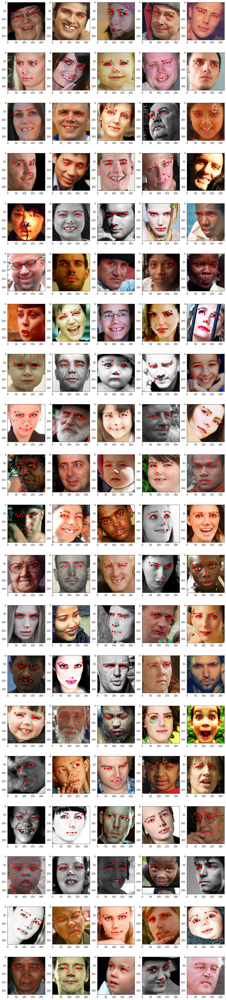

In [54]:
show_test_img_with_landmarks(PREDICTIONS, test_names, TEST_PATH)

In [55]:
# Now it is required to transform landmarks according to initial image sizes to get proper inference!
PREDICTIONS.shape

(1000, 28)

In [65]:
i = 18
image = plt.imread(os.path.join(TEST_PATH, test_names[i]))
print(image.shape)
BGR_image = cv2.imread(os.path.join(TEST_PATH, test_names[i]))
RGBimage = cv2.cvtColor(BGR_image, cv2.COLOR_BGR2RGB)
print(RGBimage.shape)

(1735, 2019, 3)
(1735, 2019, 3)


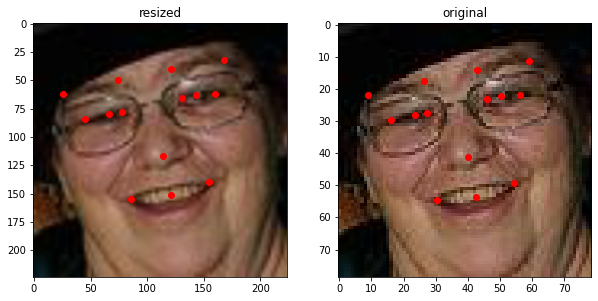

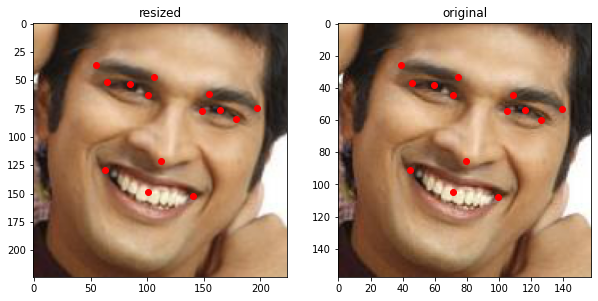

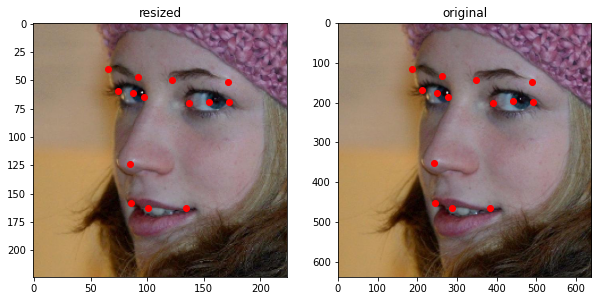

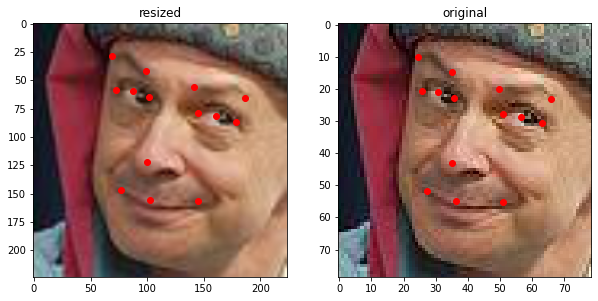

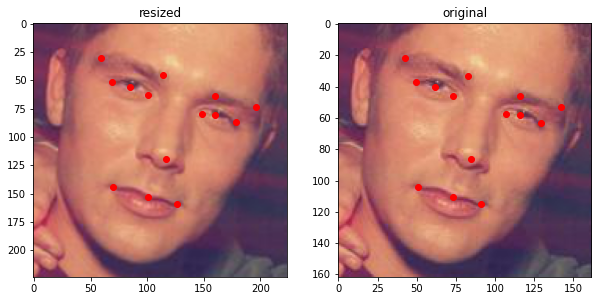

...

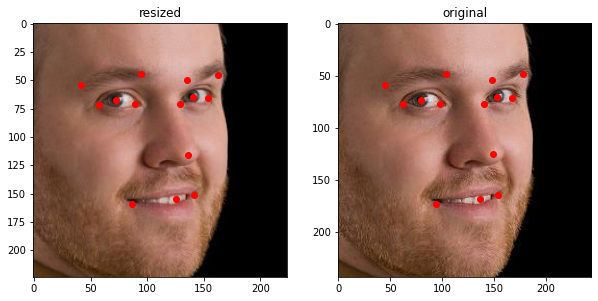

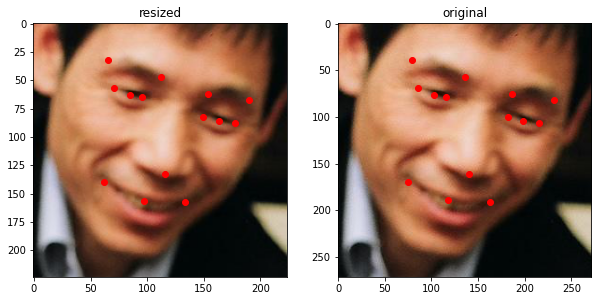

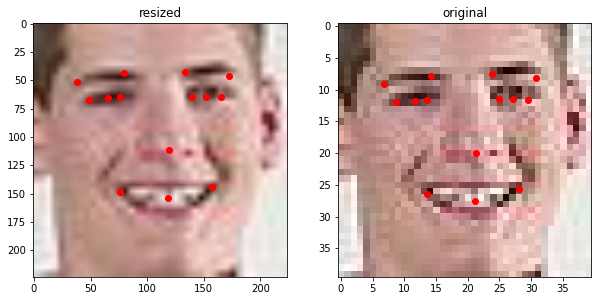

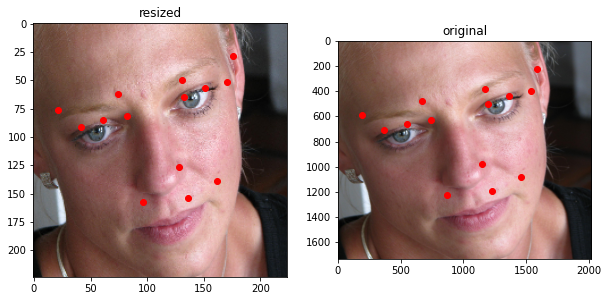

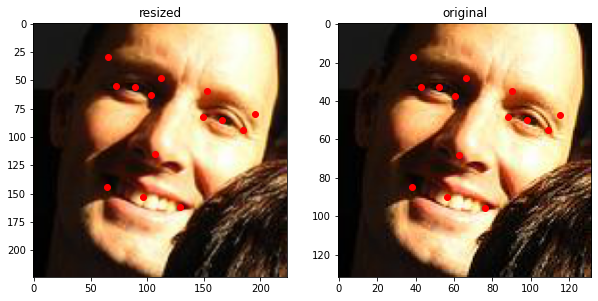

In [84]:
for i in range(20):
    plt.figure(figsize=(10,6))
    plt.subplot(1,2,1)
    image = plt.imread(os.path.join(TEST_PATH, test_names[i]))
    image = cv2.resize(image, IMSIZE[:2])
    plt.imshow(image)
    xs = [PREDICTIONS[i][j] for j in range(28) if j % 2 == 0]
    ys = [PREDICTIONS[i][j] for j in range(28) if j % 2 != 0]
    plt.scatter(x=xs, y=ys, color='r')
    plt.title('resized')
    plt.subplot(1,2,2)
    image = plt.imread(os.path.join(TEST_PATH, test_names[i]))
    plt.imshow(image)
    x_ratio = image.shape[1] / IMSIZE[1]
    y_ratio = image.shape[0] / IMSIZE[0]
    xs = [PREDICTIONS[i][j] * x_ratio for j in range(28) if j % 2 == 0]
    ys = [PREDICTIONS[i][j] * y_ratio for j in range(28) if j % 2 != 0]
    plt.scatter(x=xs, y=ys, color='r')
    plt.title('original')
    #print(PREDICTIONS[i])
    #print(sizes[i])
    plt.show()

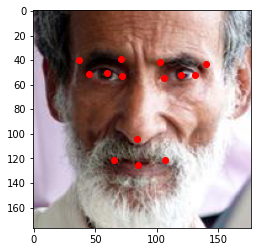

In [69]:
for prediction in PREDICTIONS:
    image = plt.imread(os.path.join(TEST_PATH, test_names[i]))
    plt.imshow(image)

    x_ratio = image.shape[1] / IMSIZE[1]
    y_ratio = image.shape[0] / IMSIZE[0]

    xs = [PREDICTIONS[i][j] * x_ratio for j in range(28) if j % 2 == 0]
    ys = [PREDICTIONS[i][j] * y_ratio for j in range(28) if j % 2 != 0]

In [183]:
train_marks.head(1)

,filename,x1,y1,x2,y2,x3,y3,x4,y4,x5,y5,x6,y6,x7,y7,x8,y8,x9,y9,x10,y10,x11,y11,x12,y12,x13,y13,x14,y14
0,05317.jpg,26.046512,57.302326,65.637209,40.632558,151.069767,37.506977,178.15814,46.883721,40.632558,77.097674,63.553488,71.888372,82.306977,75.013953,135.44186,70.846512,151.069767,67.72093,165.655814,67.72093,117.730233,107.311628,82.306977,154.195349,117.730233,154.195349,148.986047,146.902326


In [184]:
cols = train_marks.columns
cols

Index(['filename', 'x1', 'y1', 'x2', 'y2', 'x3', 'y3', 'x4', 'y4', 'x5', 'y5',
       'x6', 'y6', 'x7', 'y7', 'x8', 'y8', 'x9', 'y9', 'x10', 'y10', 'x11',
       'y11', 'x12', 'y12', 'x13', 'y13', 'x14', 'y14'],
      dtype='object')

In [185]:
coords_df = pd.DataFrame(PREDICTIONS, columns=columns[1:])
coords_df.head(3)

,x1,y1,x2,y2,x3,y3,x4,y4,x5,y5,x6,y6,x7,y7,x8,y8,x9,y9,x10,y10,x11,y11,x12,y12,x13,y13,x14,y14
0,25.269974,62.306061,74.391090,49.366554,121.307785,40.168266,167.905273,31.667002,45.385967,84.393578,66.605545,79.972931,77.655312,78.074409,130.574203,65.449203,142.879074,62.915462,159.780151,61.991077,114.012688,116.579742,85.936607,154.444946,120.929176,151.680466,154.521072,139.362213
1,54.948601,36.559586,105.872070,47.201618,154.523163,62.337727,197.202347,74.742760,64.849792,51.863880,84.511345,53.647926,100.691597,63.023731,148.675568,77.291267,164.306183,76.402557,178.445541,84.412704,112.242149,121.165047,63.197300,128.950531,101.074303,148.397202,140.752945,152.443939
2,65.321014,39.964737,92.313354,46.847542,122.309311,49.787056,171.411453,51.737484,74.049721,59.222652,87.767319,61.308693,97.126259,65.041908,137.097931,70.065170,154.288239,68.892548,172.027679,69.388351,84.553604,123.473618,86.052849,158.627838,100.680618,162.778809,134.115402,162.825592


In [186]:
names_df = pd.DataFrame(test_names, columns=[cols[0]])
names_df.head(3)

,filename
0,03443.jpg
1,03077.jpg
2,01350.jpg


In [187]:
test_marks = names_df.join(coords_df)
test_marks.head(3)

,filename,x1,y1,x2,y2,x3,y3,x4,y4,x5,y5,x6,y6,x7,y7,x8,y8,x9,y9,x10,y10,x11,y11,x12,y12,x13,y13,x14,y14
0,03443.jpg,25.269974,62.306061,74.391090,49.366554,121.307785,40.168266,167.905273,31.667002,45.385967,84.393578,66.605545,79.972931,77.655312,78.074409,130.574203,65.449203,142.879074,62.915462,159.780151,61.991077,114.012688,116.579742,85.936607,154.444946,120.929176,151.680466,154.521072,139.362213
1,03077.jpg,54.948601,36.559586,105.872070,47.201618,154.523163,62.337727,197.202347,74.742760,64.849792,51.863880,84.511345,53.647926,100.691597,63.023731,148.675568,77.291267,164.306183,76.402557,178.445541,84.412704,112.242149,121.165047,63.197300,128.950531,101.074303,148.397202,140.752945,152.443939
2,01350.jpg,65.321014,39.964737,92.313354,46.847542,122.309311,49.787056,171.411453,51.737484,74.049721,59.222652,87.767319,61.308693,97.126259,65.041908,137.097931,70.065170,154.288239,68.892548,172.027679,69.388351,84.553604,123.473618,86.052849,158.627838,100.680618,162.778809,134.115402,162.825592


In [188]:
test_sizes = []
for name in test_marks.filename:
    image = cv2.imread(os.path.join(TEST_PATH, name))
    size = image.shape
    test_sizes.append(size)

In [189]:
# The code bellow resize transform coordinates to original image size along the dataframe

xs = [test_marks.columns[col] for col in range(1, test_marks.shape[1]) if col % 2 != 0]
ys = [test_marks.columns[col] for col in range(1, test_marks.shape[1]) if col % 2 == 0]

ratio_x = np.array(test_sizes)[:, 1] / IMSIZE[1]
ratio_y = np.array(test_sizes)[:, 0] / IMSIZE[0]

test_marks[xs] = test_marks[xs] * ratio_x.reshape(-1,1)
test_marks[ys] = test_marks[ys] * ratio_y.reshape(-1,1)

test_marks.head()

,filename,x1,y1,x2,y2,x3,y3,x4,y4,x5,y5,x6,y6,x7,y7,x8,y8,x9,y9,x10,y10,x11,y11,x12,y12,x13,y13,x14,y14
0,03443.jpg,8.912178,21.974013,26.236143,17.410526,42.782656,14.166487,59.216592,11.168273,16.006658,29.763806,23.490348,28.204739,27.387364,27.535171,46.050724,23.082532,50.390388,22.188935,56.351036,21.862925,40.209832,41.115177,30.308000,54.469423,42.649129,53.494450,54.496271,49.150066
1,03077.jpg,38.758388,25.787565,74.677621,33.293999,108.994017,43.970361,139.098084,52.720339,45.742264,36.582558,59.610681,37.840948,71.023537,44.454239,104.869374,54.517948,115.894540,53.891090,125.867837,59.541104,79.170802,85.464631,44.576667,90.956178,71.293481,104.673026,99.281095,107.527421
2,01350.jpg,186.339858,114.006549,263.340328,133.640979,348.909150,142.026468,488.981780,147.590412,211.240052,168.943192,250.371949,174.893995,277.069997,185.543658,391.096330,199.873410,440.134752,196.528294,490.739675,197.942663,241.204255,352.230543,245.481118,452.514235,287.209442,464.355619,382.588134,464.489077
3,03946.jpg,24.469898,10.105288,35.041024,14.807288,49.772850,19.862012,65.850545,23.208955,25.702363,20.490244,30.870977,20.939599,35.705124,22.713588,51.085289,27.703559,56.596946,28.634340,62.986103,30.560931,35.112775,42.961108,27.168619,51.865889,36.270827,54.992737,51.085219,55.109519
4,00747.jpg,42.759002,21.857418,82.602921,32.945420,115.706042,46.329183,142.149282,53.231831,49.575972,37.139122,61.601352,40.196108,72.864043,45.807654,107.242705,57.664085,115.981342,58.136895,129.358047,63.033120,84.438755,86.255277,50.480547,104.157534,72.871139,110.512751,91.315906,115.036206


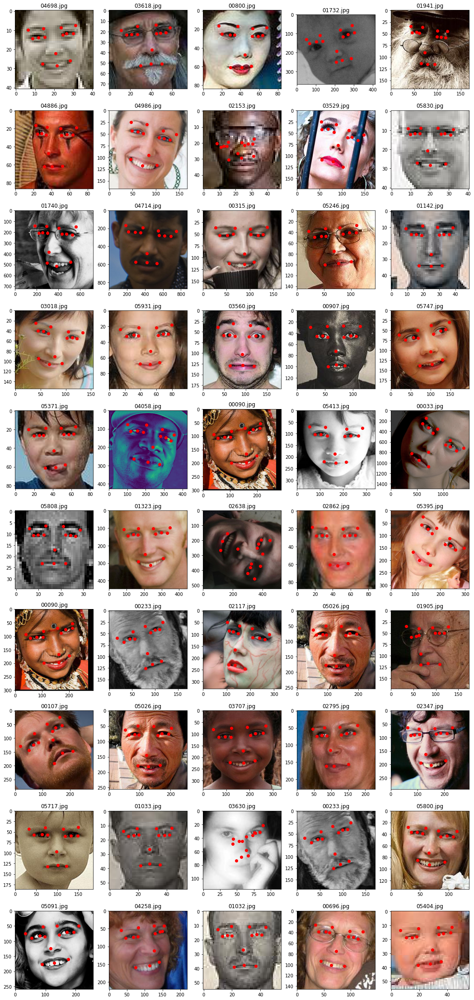

In [190]:
# look at test data with predicted marks flowing from dataframe!
idx_to_show = np.random.randint(0, 999, 50)
image_names_to_show = [test_names[idx] for idx in idx_to_show]

plt.figure(figsize=(18,40))
for i, image_name in enumerate(image_names_to_show):
    plt.subplot(10,5,i+1)
    show_picture_with_marks(TEST_PATH, image_name, test_marks)
    plt.title(image_name)

In [191]:
test_marks.to_csv('/content/test_landmarks.csv', sep=',', index=False)
files.download('/content/test_landmarks.csv')

In [222]:
doublecheck_df = pd.read_csv('/content/test_landmarks.csv')

In [169]:
"""
The present model are good at localization of landmarks of the vertical flipped face as well as the face located on the center or rotated a little. 
The model's ability to localize the face rotated on 90 degrees (e.g laying horizontally) is still low. 

Futher resuarch is required:

1. It seems that color augmentation is not necessary for this task, but it's stil worth to try!
2. More advanced data augmentation is requinred (left/right 90-degree rotation, horisontal and vertical shifts)
3. The presence of landmarks with coordinates complicates completion of advanced data augmentation
    because such augmentation requires corresponding transformations of landmarks' coordinates.
"""